**DS250 : Assignment 2**
- **Animesh Raj : 11940120**
- **Puja Bansal : 11940910**

Importing Data-set 

In [82]:
from google.colab import files
uploaded = files.upload()

Saving Output.csv to Output (1).csv


In [149]:
import pandas as pd

df = pd.read_csv('Output.csv')
df = df[['Link', 'Label']]
df

,Link,Label
0,https://en.wikipedia.org/wiki/Absolute_value,1
1,https://en.wikipedia.org/wiki/Addition_theorem,1
2,https://en.wikipedia.org/wiki/Adjugate_matrix,2
3,https://en.wikipedia.org/wiki/Algebra_of_sets,2
4,https://en.wikipedia.org/wiki/Algorithm,2
...,...,...
459,https://en.wikipedia.org/wiki/Wald%E2%80%93Wol...,1
460,https://en.wikipedia.org/wiki/Weibull_distribu...,2
461,https://en.wikipedia.org/wiki/Weighted_arithme...,1
462,https://en.wikipedia.org/wiki/Wiener%E2%80%93K...,3


Finding Hyperlinks from a wiki page to other wiki pages

In [84]:
from bs4 import BeautifulSoup
import requests

counter = 0

def find_edges(link_table):
  
  global counter
  counter += 1
  li = []
  print(counter, link_table)
  
  req = requests.get(link_table)
  soup = BeautifulSoup(req.text,"html.parser")
  
  for link in soup.find_all('a'):
  
    l = link.get('href')
    
    if l is not None and l.startswith('/wiki/') and ":" not in l:
      
      l_link = 'https://en.wikipedia.org' + l
      
      l_link = l_link.split('#')[0]
      
      li.append(l_link)
  
  return list(set(li))

In [85]:
# for i in range(2):
#   r = df['Link'][i]
#   print(find_edges(r))

Graph Building

In [86]:
GRAPH_SIZE = 1000

def build_graph(links):

    # BFS QUEUE
    queue = links.copy()

    # Visited will also store the parent link
    visited = {}
    
    # Current Size of the graph
    size = len(queue)
    
    if(len(queue) > GRAPH_SIZE):
        queue = queue[:GRAPH_SIZE]
    
    for link in queue:
        visited[link] = list() # Empty list for parent links

    while queue:

        if size >= GRAPH_SIZE:
            break
        
        front = queue.pop(0)
        
        children = find_edges(front)
        
        for child in children:
            if child not in visited:
                visited[child] = [front]
                queue.append(child)
                size += 1
                
                if size >= GRAPH_SIZE:
                    break
            else:
                visited[child].append(front)
                
        if size >= GRAPH_SIZE:
            break
    
    # Now, check for all nodes, if there exist more edges
    nodes_list = list(visited.keys())
    for node in nodes_list:
        
        # Find children of the node
        children = find_edges(node)
        
        # If any child is in the graph
        for n in children:
            if n in nodes_list and n != node:
                
                # If there is already edge from node to n, continue
                if node in visited[n]:
                    continue
                
                visited[n].append(node)
            
    return visited

Extraction of root nodes

In [150]:
Start_Nodes = []
Labels = {}
for i in range(len(df)):
    Start_Nodes.append(df['Link'][i])
    Labels[df['Link'][i]] = df['Label'][i]

start_labels = Labels.copy()

In [88]:
node_mapping = build_graph(Start_Nodes)

1 https://en.wikipedia.org/wiki/Absolute_value
2 https://en.wikipedia.org/wiki/Addition_theorem
3 https://en.wikipedia.org/wiki/Adjugate_matrix
4 https://en.wikipedia.org/wiki/Algebra_of_sets
5 https://en.wikipedia.org/wiki/Algorithm
6 https://en.wikipedia.org/wiki/Absolute_value
7 https://en.wikipedia.org/wiki/Addition_theorem
8 https://en.wikipedia.org/wiki/Adjugate_matrix
9 https://en.wikipedia.org/wiki/Algebra_of_sets
10 https://en.wikipedia.org/wiki/Algorithm
11 https://en.wikipedia.org/wiki/Altitude_(triangle)
12 https://en.wikipedia.org/wiki/Angle_bisector_theorem
13 https://en.wikipedia.org/wiki/Antiderivative
14 https://en.wikipedia.org/wiki/Area_under_the_curve_(pharmacokinetics)
15 https://en.wikipedia.org/wiki/Arithmetic_mean
16 https://en.wikipedia.org/wiki/Arithmetic_progression
17 https://en.wikipedia.org/wiki/Arithmetico%E2%80%93geometric_sequence
18 https://en.wikipedia.org/wiki/Arithmetico–geometric_sequence
19 https://en.wikipedia.org/wiki/Asymptote
20 https://en.wik

Graph building

In [89]:
# Adjacency List Building
adj = {}
for c in node_mapping.keys():
    p = node_mapping[c]
    if c not in adj:
        adj[c] = []
    for parent in p:            
        if parent not in adj:
            adj[parent] = []
        adj[parent].append(c)

In [90]:
import networkx as nx
import matplotlib.pyplot as plt

def draw_graph(adj, Labels):
  
  Colors = ['pink', 'green', 'yellow', 'red']  
  node_colors = []
  
  G = nx.DiGraph()

  # For each node in the graph, add its children
  for node in adj.keys():
      if node not in G.nodes():
          G.add_node(node)
          if node in Labels:
              i = int(Labels[node])
              node_colors.append(Colors[i])
          else:
              node_colors.append('black')
              
      for child in adj[node]:
          # If the child is not already in the graph, add it
          if child not in G.nodes():    
              G.add_node(child)
              if child in Labels:
                  i = int(Labels[child])
                  node_colors.append(Colors[i])
              else:
                  node_colors.append('black')
          G.add_edge(node, child)
  
  # Graph Plotting

  f = plt.figure()
  f.set_size_inches(70, 70)
  nx.draw(G, node_color=node_colors)

  plt.show()

  return G


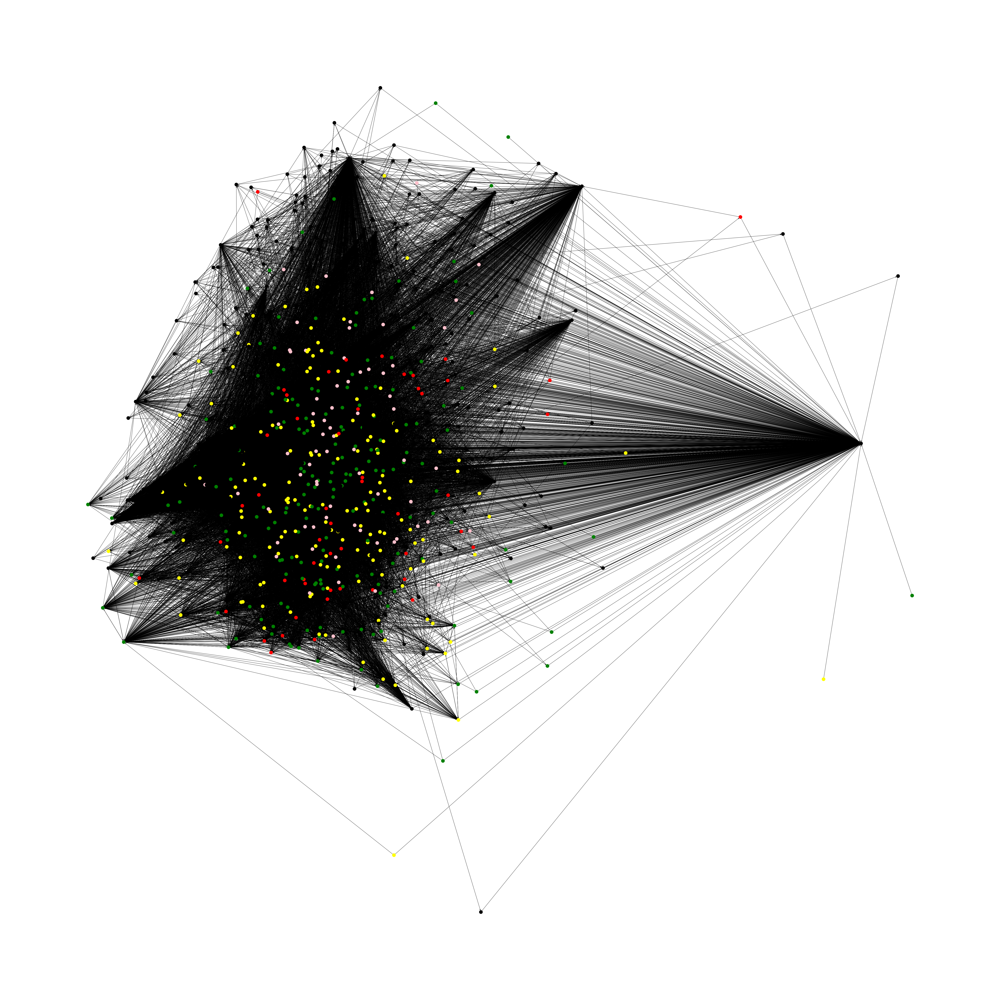

In [91]:
G = draw_graph(adj, Labels)

In [92]:
nx.pagerank(G)

{'https://en.wikipedia.org/wiki/Absolute_value': 0.002362565088737127,
 'https://en.wikipedia.org/wiki/Antiderivative': 0.0017151577462998025,
 'https://en.wikipedia.org/wiki/Complex_conjugate': 0.0013946606123056123,
 'https://en.wikipedia.org/wiki/Complex_number': 0.004868955902840983,
 'https://en.wikipedia.org/wiki/Complex_plane': 0.0016100792111566251,
 'https://en.wikipedia.org/wiki/Constant_of_integration': 0.0010970873785614732,
 'https://en.wikipedia.org/wiki/Continuous_function': 0.002935002082548582,
 'https://en.wikipedia.org/wiki/Convex_function': 0.0005469153544179846,
 'https://en.wikipedia.org/wiki/Determinant': 0.002383538686912038,
 'https://en.wikipedia.org/wiki/Distance': 0.0007817534885558399,
 'https://en.wikipedia.org/wiki/Euclidean_space': 0.002705944991224227,
 'https://en.wikipedia.org/wiki/Inner_product_space': 0.0011775935152309657,
 'https://en.wikipedia.org/wiki/Interval_(mathematics)': 0.0015171173138631955,
 'https://en.wikipedia.org/wiki/Inverse_functio

Centrality metrics

In [93]:
# Calculating Centralities using the networkX library
degree_centralities = nx.degree_centrality(G)
clustering_coefficients = nx.clustering(G)
closeness_centralities = nx.closeness_centrality(G)
betweenness_centralities = nx.betweenness_centrality(G)
page_ranks = nx.pagerank(G)

In [94]:
# sample printing
testNode = list(adj.keys())[0]

print(testNode)
print(degree_centralities[testNode])
print(clustering_coefficients[testNode])
print(closeness_centralities[testNode])
print(betweenness_centralities[testNode])
print(page_ranks[testNode])

https://en.wikipedia.org/wiki/Absolute_value
0.2022022022022022
0.1034795306913742
0.47495132548170155
0.026558528127720266
0.002362565088737127


In [95]:
# creating an empty table intializing all values to 0
data_table = pd.DataFrame(columns = adj.keys(),index = df.index)
data_table = data_table.fillna(0)
data_table = data_table.T
data_table.head()

,0,1,2,3,4,5,6,7,8,9,...,454,455,456,457,458,459,460,461,462,463
https://en.wikipedia.org/wiki/Absolute_value,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
https://en.wikipedia.org/wiki/Cauchy_sequence,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
https://en.wikipedia.org/wiki/Chebyshev%27s_inequality,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
https://en.wikipedia.org/wiki/Coefficient_matrix,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
https://en.wikipedia.org/wiki/Coefficient_of_variation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [96]:
centrality_dataframe = data_table.copy()
for i in centrality_dataframe.index:
  centrality_dataframe.loc[i, 'degree_centrality'] = degree_centralities[i]
  centrality_dataframe.loc[i, 'local_clustering_coefficient'] = clustering_coefficients[i]
  centrality_dataframe.loc[i, 'closeness_centrality'] = closeness_centralities[i]
  centrality_dataframe.loc[i, 'betweenness_centrality'] = betweenness_centralities[i]
  centrality_dataframe.loc[i, 'page_rank'] = page_ranks[i]
centrality_dataframe[['degree_centrality', 'local_clustering_coefficient', 'closeness_centrality', 'betweenness_centrality', 'page_rank']]

,degree_centrality,local_clustering_coefficient,closeness_centrality,betweenness_centrality,page_rank
https://en.wikipedia.org/wiki/Absolute_value,0.202202,0.103480,0.474951,2.655853e-02,0.002363
https://en.wikipedia.org/wiki/Cauchy_sequence,0.065065,0.356450,0.402554,1.450620e-03,0.000944
https://en.wikipedia.org/wiki/Chebyshev%27s_inequality,0.028028,0.346257,0.303746,1.929465e-04,0.000298
https://en.wikipedia.org/wiki/Coefficient_matrix,0.015015,0.456311,0.321701,4.493059e-05,0.000265
https://en.wikipedia.org/wiki/Coefficient_of_variation,0.066066,0.691509,0.375973,3.056073e-04,0.000734
...,...,...,...,...,...
https://en.wikipedia.org/wiki/Unisys,0.006006,0.464286,0.336080,5.926860e-07,0.000244
https://en.wikipedia.org/wiki/Execution_(computing),0.011011,0.351852,0.339204,2.289469e-05,0.000269
https://en.wikipedia.org/wiki/7400_series,0.004004,0.500000,0.335621,0.000000e+00,0.000203
https://en.wikipedia.org/wiki/Association_for_Computing_Machinery,0.024024,0.197080,0.386597,1.352182e-04,0.000766


Node2Vec embeddings for nodes

In [97]:
!pip install node2vec

In [98]:
# Get node embeddings using Node2Vec
from node2vec import Node2Vec

node2vec_embeddings = {}

# Precompute probabilities and generate walks
node2vec = Node2Vec(G, dimensions=100, walk_length=15, num_walks=200, workers=4)

# Generate the embeddings model
node_embedding_model = node2vec.fit(window=10, min_count=1, batch_words=4)

for node in adj.keys():
    node2vec_embeddings[node] = node_embedding_model.wv.get_vector(node)

Computing transition probabilities:   0%|          | 0/1000 [00:00<?, ?it/s]

In [99]:
testNode = list(adj.keys())[0]
print(testNode)
print(node2vec_embeddings[testNode])

https://en.wikipedia.org/wiki/Absolute_value
[ 0.04371115 -0.00438503  0.18361378 -0.00482404 -0.31360248  0.2003
 -0.19704364 -0.07574937  0.10172118 -0.38268134 -0.11587147  0.48445606
  0.10643302  0.02432632 -0.31351435  0.13610974  0.01689226  0.4512662
  0.1681005   0.02253694  0.1185932  -0.279901    0.44268993 -0.2807638
  0.1873921  -0.05100132 -0.316418   -0.03299806  0.17737748 -0.03007533
 -0.17453465 -0.08884988 -0.09682012 -0.03405942 -0.05262031 -0.36173925
  0.09586488 -0.07691833 -0.0364854   0.02535463 -0.08757646  0.4042461
 -0.3592535   0.17352237 -0.31382838  0.02721    -0.07135649 -0.05503266
 -0.37909707 -0.07213081 -0.35124975  0.31064638 -0.07188267 -0.86381954
 -0.13435662  0.17623372  0.14830734 -0.51913846  0.12850352  0.38614768
 -0.22651589  0.10012833  0.2591179   0.16906682  0.25413865  0.25596562
 -0.32146096  0.06697594  0.24607852  0.09299192  0.2577581  -0.24097915
 -0.23873095 -0.12677424  0.18623775  0.40873247  0.17700136  0.20892763
 -0.21233737 

In [100]:
index_node2vec = data_table.index
node2vec_table = data_table.copy()
node2vec_tables = pd.DataFrame.from_dict(node2vec_embeddings, orient="index")
node2vec_tables

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
https://en.wikipedia.org/wiki/Absolute_value,0.043711,-0.004385,0.183614,-0.004824,-0.313602,0.200300,-0.197044,-0.075749,0.101721,-0.382681,...,0.036292,-0.052098,-0.190555,0.192742,0.009390,0.310976,-0.017103,-0.231476,0.055392,0.280020
https://en.wikipedia.org/wiki/Cauchy_sequence,0.043227,-0.358190,0.203651,-0.242558,-0.418506,-0.283110,-0.402559,-0.134627,0.199203,0.014563,...,0.362868,-0.167933,0.381276,-0.097840,-0.285823,-0.252069,-0.022900,0.146417,0.092147,-0.100708
https://en.wikipedia.org/wiki/Chebyshev%27s_inequality,0.109539,0.312618,-0.128788,-0.222159,-0.154978,-0.087273,-0.350256,-0.185016,0.334779,-0.272199,...,0.021977,0.162392,-0.306096,0.083105,0.296952,-0.002887,0.075632,0.042465,0.261931,0.179185
https://en.wikipedia.org/wiki/Coefficient_matrix,0.295588,0.028194,0.237930,-0.020051,-0.185662,0.161339,0.221352,-0.143098,0.096455,-0.007536,...,-0.056066,0.187760,-0.124417,0.546194,-0.316622,-0.147800,0.080033,-0.132558,-0.173994,0.039442
https://en.wikipedia.org/wiki/Coefficient_of_variation,-0.106767,0.171109,-0.073524,-0.447933,-0.471270,0.209350,-0.476111,-0.103618,-0.053378,-0.138692,...,0.477629,-0.339694,-0.214243,-0.528788,-0.030600,-0.163579,0.220992,-0.175608,-0.102286,0.054457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
https://en.wikipedia.org/wiki/Unisys,-0.345400,0.420434,0.435464,-0.536315,-0.378011,0.753740,-0.182447,0.392476,-0.124581,0.188142,...,0.063019,0.532865,0.005347,-0.038439,-0.655511,-0.225400,0.016709,-0.467822,0.337542,-0.373926
https://en.wikipedia.org/wiki/Execution_(computing),-0.017577,-0.247520,-0.206792,-0.766940,-0.361849,0.234276,-0.094771,0.132340,-0.078549,0.850818,...,0.037820,0.470929,-0.183920,0.209863,-0.151096,0.164073,-0.082598,0.419529,-0.116991,0.359422
https://en.wikipedia.org/wiki/7400_series,0.326775,0.282721,0.264883,-0.080412,-0.204251,0.020267,-0.285080,0.160630,0.065769,0.278247,...,-0.067650,0.197586,0.023746,-0.251443,-0.620104,-0.322480,-0.034699,-0.236405,0.064703,0.245106
https://en.wikipedia.org/wiki/Association_for_Computing_Machinery,-0.107372,0.258754,-0.255106,-0.354804,-0.488545,0.282108,-0.198406,-0.266592,-0.278191,0.763090,...,-0.477540,-0.076611,-0.167371,-0.174308,-0.484908,0.109522,-0.099325,-0.073957,-0.111236,-0.131346


Contents extraction from Wikipedia Links

In [101]:
import time

def get_content(node):
    
    time.sleep(0.01)

    res = requests.get(node)
    soup = BeautifulSoup(res.text, 'html.parser')

    # Get the content of the page
    content = soup.find('div', {'id': 'mw-content-text'})

    # Get the text of the content
    text = content.get_text()

    return text

In [102]:
node_text = {}
for node in list(node_mapping.keys()):
    node_text[node] = get_content(node)
    print(node)

https://en.wikipedia.org/wiki/Absolute_value
https://en.wikipedia.org/wiki/Addition_theorem
https://en.wikipedia.org/wiki/Adjugate_matrix
https://en.wikipedia.org/wiki/Algebra_of_sets
https://en.wikipedia.org/wiki/Algorithm
https://en.wikipedia.org/wiki/Altitude_(triangle)
https://en.wikipedia.org/wiki/Angle_bisector_theorem
https://en.wikipedia.org/wiki/Antiderivative
https://en.wikipedia.org/wiki/Area_under_the_curve_(pharmacokinetics)
https://en.wikipedia.org/wiki/Arithmetic_mean
https://en.wikipedia.org/wiki/Arithmetic_progression
https://en.wikipedia.org/wiki/Arithmetico%E2%80%93geometric_sequence
https://en.wikipedia.org/wiki/Arithmetico–geometric_sequence
https://en.wikipedia.org/wiki/Asymptote
https://en.wikipedia.org/wiki/Basis_(linear_algebra)
https://en.wikipedia.org/wiki/Bayes%27_theorem
https://en.wikipedia.org/wiki/Bayesian_probability
https://en.wikipedia.org/wiki/Bennett%27s_inequality
https://en.wikipedia.org/wiki/Bernoulli_differential_equation
https://en.wikipedia.or

NLTK import

In [103]:
nltk.download("all") 
import nltk

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package basque_grammars is already up-to-date!
[nltk_data]    | Downloading package biocreative_ppi to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Pac

NLTK keywords extraction

In [104]:
# Extract keywords from the node summary using nltk
stopwords = nltk.corpus.stopwords.words('english')
stemmer = nltk.stem.PorterStemmer()

def Keyword_Extraction(text):
    
    tokens = nltk.word_tokenize(text)

    # Change to lowercase
    tokens = [w.lower() for w in tokens]

    # Remove stopwords
    tokens = [token for token in tokens if token not in stopwords]

    # There should only be english characters in the token
    tokens = [token for token in tokens if token.isalpha()]

    # Take only nouns using nltk
    final_tokens = []
    for token in tokens:

        # Tag the token 
        tagged_token = nltk.pos_tag([token])
        tag = tagged_token[0][1]

        # If the token is a noun
        if tag == 'NN' or tag == 'NNS' or tag == 'NNP' or tag == 'NNPS':
            final_tokens.append(token)

    # Stem the tokens
    final_tokens = [stemmer.stem(token) for token in final_tokens]    
    
    # Remove keywords of length 1
    final_tokens = [token for token in final_tokens if len(token) > 1]

    return final_tokens

Bag of Words Model : Better alternative is used and hence, the below code is commented

In [105]:
# Cleaning the text
'''import re
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

ps = PorterStemmer()
wordnet=WordNetLemmatizer()
sentences = nltk.sent_tokenize(node_text[node]) #Tokenizing 
corpus = []
for i in range(len(sentences)):
    review = re.sub('[^a-zA-Z]', ' ', sentences[i]) 
    review = review.lower() #Lowering the sentence 
    review = review.split() #Splitting it into words
    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))] #Applying stemming
    review = ' '.join(review)
    corpus.append(review)    

# Creating the Bag of Words model
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features = 10)
X = cv.fit_transform(corpus).toarray()
print(len(sentences)) #Checking the number of sentences in the paragraph 
print(X) # Printing the final feature matrix 
print(X.shape) # Shape of the feature matrix 
print(corpus) # Printing the processed text 
print(sentences) # Printing the original text '''

"import re\nfrom nltk.corpus import stopwords\nfrom nltk.stem.porter import PorterStemmer\nfrom nltk.stem import WordNetLemmatizer\n\nps = PorterStemmer()\nwordnet=WordNetLemmatizer()\nsentences = nltk.sent_tokenize(node_text[node]) #Tokenizing \ncorpus = []\nfor i in range(len(sentences)):\n    review = re.sub('[^a-zA-Z]', ' ', sentences[i]) \n    review = review.lower() #Lowering the sentence \n    review = review.split() #Splitting it into words\n    review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))] #Applying stemming\n    review = ' '.join(review)\n    corpus.append(review)    \n\n# Creating the Bag of Words model\nfrom sklearn.feature_extraction.text import CountVectorizer\ncv = CountVectorizer(max_features = 10)\nX = cv.fit_transform(corpus).toarray()\nprint(len(sentences)) #Checking the number of sentences in the paragraph \nprint(X) # Printing the final feature matrix \nprint(X.shape) # Shape of the feature matrix \nprint(corpus) # Print

Extracting Keywords from Node Contents

In [106]:
# NLP FEATURES OF NODES
node_keywords = {}

for node in node_text.keys():

    # Extract keywords from the node summary
    keywords = Keyword_Extraction(node_text[node])

    # Add the keywords to the dictionary
    node_keywords[node] = keywords
    
    print(node)

https://en.wikipedia.org/wiki/Absolute_value
https://en.wikipedia.org/wiki/Addition_theorem
https://en.wikipedia.org/wiki/Adjugate_matrix
https://en.wikipedia.org/wiki/Algebra_of_sets
https://en.wikipedia.org/wiki/Algorithm
https://en.wikipedia.org/wiki/Altitude_(triangle)
https://en.wikipedia.org/wiki/Angle_bisector_theorem
https://en.wikipedia.org/wiki/Antiderivative
https://en.wikipedia.org/wiki/Area_under_the_curve_(pharmacokinetics)
https://en.wikipedia.org/wiki/Arithmetic_mean
https://en.wikipedia.org/wiki/Arithmetic_progression
https://en.wikipedia.org/wiki/Arithmetico%E2%80%93geometric_sequence
https://en.wikipedia.org/wiki/Arithmetico–geometric_sequence
https://en.wikipedia.org/wiki/Asymptote
https://en.wikipedia.org/wiki/Basis_(linear_algebra)
https://en.wikipedia.org/wiki/Bayes%27_theorem
https://en.wikipedia.org/wiki/Bayesian_probability
https://en.wikipedia.org/wiki/Bennett%27s_inequality
https://en.wikipedia.org/wiki/Bernoulli_differential_equation
https://en.wikipedia.or

Code to calculate Co-Occurance Matrix

In [107]:
# sklearn countvectorizer
from sklearn.feature_extraction.text import CountVectorizer
# Convert a collection of text documents to a matrix of token counts
cv = CountVectorizer(ngram_range=(1,1), stop_words = 'english')
# matrix of token counts
X = cv.fit_transform(keywords)
Xc = (X.T * X) # matrix manipulation
Xc.setdiag(0) # set the diagonals to be zeroes as it's pointless to be 1


In [108]:
names = cv.get_feature_names_out() # This are the entity names (i.e. keywords)
df1 = pd.DataFrame(data = Xc.toarray(), columns = names, index = names)
df1

,abbr,absolut,aid,algorithm,answer,articl,auto,avoid,background,block,...,thesi,transpar,ul,univers,url,valu,varieti,vtemetalog,wikipedia,word
abbr,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
absolut,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aid,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
algorithm,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
answer,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
valu,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
varieti,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
vtemetalog,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
wikipedia,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Word2Vec Embeddings

In [109]:
from gensim.models import Word2Vec as w2v
import numpy as np
# Get word embeddigs using Word2Vec

# Prepping Sentences
sentences = []
for node in adj.keys():
    # Append keywords to the list
    sentences.append(node_keywords[node])

# Generate the embeddings model
word_embedding_model = w2v(sentences, window=5, min_count=1, workers=1)

# Get the embeddings for each node
node_w2v_embeddings = {}

for node in adj.keys():
    
    nodeKeywords = node_keywords[node]
    sum = np.zeros(100)
    
    # This is term frequency weighted Average of the word embeddings
    for keyword in nodeKeywords:
        sum += word_embedding_model.wv[keyword]

    sum = sum / len(nodeKeywords)
    
    node_w2v_embeddings[node] = sum

In [110]:
print(node_w2v_embeddings[list(adj.keys())[0]])

[-0.54451217  0.40407099  0.63444355  0.936844   -0.51963636 -0.54718174
 -0.34653388  0.91150138  0.08937817 -0.3112991   0.42700422  0.26577687
 -0.04406622  0.24149401  0.13497477 -0.35066767 -0.08566034 -0.70727093
  0.39419763  1.19442175  0.72884004 -0.4184562  -0.34677387  0.25879558
 -0.8641006  -0.89672807  0.08635633 -0.15817871  0.14130454 -0.18883348
 -0.22478599 -0.46315088 -0.94927797 -0.11978564 -0.52764592 -0.77251796
  0.58300029 -1.07463437 -0.30233421  0.10175293 -0.30860622  0.28529517
 -0.35815496 -0.05085567 -0.13217585 -0.88798163 -0.1969183  -0.55127666
 -0.93985901 -0.26878596  0.17269688  0.21922085 -0.32757815 -0.34246911
 -0.14396289  1.25625782 -1.10402843  0.20010073 -0.40499859 -0.12819108
 -0.13477238 -1.06972773 -0.14291324 -0.33005751  0.1461627   0.74250119
  0.28685959  0.52758397 -0.04924231 -0.64630814  0.7556491   0.04434754
  1.36445785 -0.25390234  0.21908718 -0.81344619  0.75262086 -0.16160752
  1.11575525  0.58668121 -0.38650272  0.045913    0

In [111]:
index_word2vec = data_table.index
word2vec_table = data_table.copy()
word2vec_tables = pd.DataFrame.from_dict(node_w2v_embeddings, orient="index")
word2vec_tables

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
https://en.wikipedia.org/wiki/Absolute_value,-0.544512,0.404071,0.634444,0.936844,-0.519636,-0.547182,-0.346534,0.911501,0.089378,-0.311299,...,-0.614885,-0.858402,-0.541245,-0.068653,1.026009,-1.290055,-0.233046,-0.383619,0.393814,0.654667
https://en.wikipedia.org/wiki/Cauchy_sequence,-0.597577,0.375795,0.663140,0.649215,-0.620849,-0.075916,-0.285510,0.675423,0.019830,-0.248358,...,-0.435886,-0.769126,-0.626205,-0.343014,0.649620,-1.279960,-0.109470,-0.477014,0.068590,0.477854
https://en.wikipedia.org/wiki/Chebyshev%27s_inequality,-0.246778,0.699770,0.896977,0.429214,-0.505234,-0.374431,-0.321942,0.063969,-0.082735,-0.264434,...,-0.159780,-0.109714,-0.541495,0.245890,0.651638,-0.899719,-0.424199,-0.423499,0.273901,0.323206
https://en.wikipedia.org/wiki/Coefficient_matrix,-0.264634,0.645204,0.734448,0.655945,-0.435883,-0.152054,-0.325259,0.728154,0.086525,-0.214153,...,-0.508026,-0.824830,-1.011500,0.514094,0.501303,-1.297521,-0.135272,0.116634,-0.149490,0.681421
https://en.wikipedia.org/wiki/Coefficient_of_variation,-0.247941,0.763168,0.829806,0.720388,-0.749372,-0.143680,-0.108195,0.251555,-0.031273,0.037604,...,-0.326228,-0.285867,-0.807782,0.220497,0.365504,-0.737757,-0.280168,-0.377600,0.259838,0.372881
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
https://en.wikipedia.org/wiki/Unisys,-0.261689,0.748780,0.276754,0.227687,-0.404583,-0.170731,-0.196102,0.155541,0.519573,0.160499,...,0.126029,-0.232640,-0.635738,0.144745,-0.223508,-0.136596,0.126751,-0.207330,0.140141,0.172281
https://en.wikipedia.org/wiki/Execution_(computing),-0.344919,0.541521,0.300354,0.539508,-0.797858,0.113454,-0.293740,0.637552,0.501239,0.149946,...,0.126928,-0.322131,-0.911331,-0.075764,-0.032894,-0.612756,0.226079,-0.251787,0.080266,0.313080
https://en.wikipedia.org/wiki/7400_series,-0.361587,0.392410,0.234070,0.574570,-0.436186,0.062765,-0.299228,0.453509,0.572455,0.109097,...,-0.132537,-0.288817,-0.593814,0.036313,0.008011,-0.330093,0.006419,-0.287600,0.112980,0.114401
https://en.wikipedia.org/wiki/Association_for_Computing_Machinery,-0.378205,1.011160,0.355438,0.540912,-0.287600,0.023940,-0.307470,0.159771,1.121471,0.197189,...,0.012743,-0.180034,-0.862766,0.184979,-0.001491,0.032049,0.019924,-0.396093,0.220751,-0.238666


Label propogation

In [112]:
from sklearn.preprocessing import MinMaxScaler # for feature scaling
from sklearn.metrics import classification_report # for model evaluation metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay # for showing confusion matrix
from sklearn.preprocessing import MinMaxScaler # for feature scaling
from sklearn.semi_supervised import LabelPropagation # for assigning labels to unlabeled data

# Step-1: Creating the X and Y
# Creating X and Y for the model
X = centrality_dataframe.to_numpy()
Y = []

for node in adj.keys():
    if node in Labels:
        Y.append(Labels[node])
    else:
        # This means the label is undefined
        Y.append(-1)

# Step-2: MinMaxScaling
sc = MinMaxScaler()
# Scaling the features
X = sc.fit_transform(X)
Y = np.array(Y)

# Step-3: Creating the Model
# Creating the Label Propagation model
model_LP_knn = LabelPropagation(kernel='knn',    # {'knn', 'rbf'} default='rbf'
                              #gamma=70,         # default=20, Parameter for rbf kernel.
                              n_neighbors=5,    # default=7, Parameter for knn kernel which is a strictly positive integer.
                              max_iter=1000,     # default=30, Maximum number of iterations allowed.
                              tol=0.001,         # default=1e-3, Convergence tolerance: threshold to consider the system at steady state.
                             )

In [113]:
# Step-4: Fit the Model
# Training the Model
model_LP_knn.fit(X, Y)

LabelPropagation(kernel='knn', n_neighbors=5)

In [114]:
# Predicting the labels for the unlabeled data
Y_pred = model_LP_knn.transduction_

print(Y_pred)

[1 0 2 2 2 1 2 1 2 2 2 2 2 1 2 2 1 1 1 3 3 1 2 2 1 0 2 1 1 2 2 0 1 1 2 1 1
 0 1 3 2 1 1 1 1 1 2 3 2 1 2 1 1 0 1 0 1 0 1 1 1 1 2 1 0 0 1 1 3 1 2 2 1 0
 2 1 0 1 0 1 2 1 1 0 1 2 0 2 1 3 1 0 2 1 1 1 1 2 2 1 2 1 2 2 0 2 1 1 2 2 2
 3 2 2 2 0 2 2 1 1 1 0 2 1 1 2 0 1 0 0 0 0 0 0 2 0 0 0 0 1 0 0 0 0 1 3 1 2
 0 0 0 0 0 0 0 1 1 0 2 0 2 0 0 0 0 0 0 0 0 0 2 0 1 2 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 2 0 0 1 0 1 0 2 1 0 0 0 2 0 2 0 1 0 0 1 2 0 0 0 0 0 2 0 0 0 2
 0 0 2 2 0 2 0 0 2 0 0 0 2 2 1 1 0 2 0 0 0 2 0 2 0 0 2 0 0 2 1 1 2 2 1 1 1
 1 1 1 0 1 2 0 1 1 1 2 2 2 1 0 1 0 1 1 1 2 2 2 0 1 1 0 2 2 1 1 0 1 1 1 2 1
 1 1 2 1 0 1 2 1 1 3 0 1 2 2 2 1 0 1 2 3 0 3 1 0 1 2 2 1 0 0 1 1 2 1 1 0 0
 1 2 1 1 2 1 1 1 1 2 2 2 1 3 1 0 2 1 0 2 0 1 2 2 1 1 2 1 3 1 0 1 2 1 1 1 1
 1 1 1 1 2 1 2 1 1 2 2 1 1 1 1 0 1 2 0 2 0 2 1 1 1 1 0 1 1 1 3 0 1 1 1 3 1
 2 2 0 1 2 1 2 1 2 2 2 3 2 3 1 1 2 1 2 0 1 3 2 2 2 1 1 3 3 1 3 3 2 0 3 0 0
 3 1 2 2 2 2 1 1 1 1 1 3 2 0 0 1 1 1 3 1 1 2 3 2 3 1 1 2 2 2 0 0 3 2 0 0 1
 0 3 0 1 1 2 3 0 0 1 1 2 

In [115]:
# Creating the label dict
nodes = centrality_dataframe.index.tolist()
Labels = dict()
for node in nodes:
    Labels[node] = int(Y_pred[nodes.index(node)])

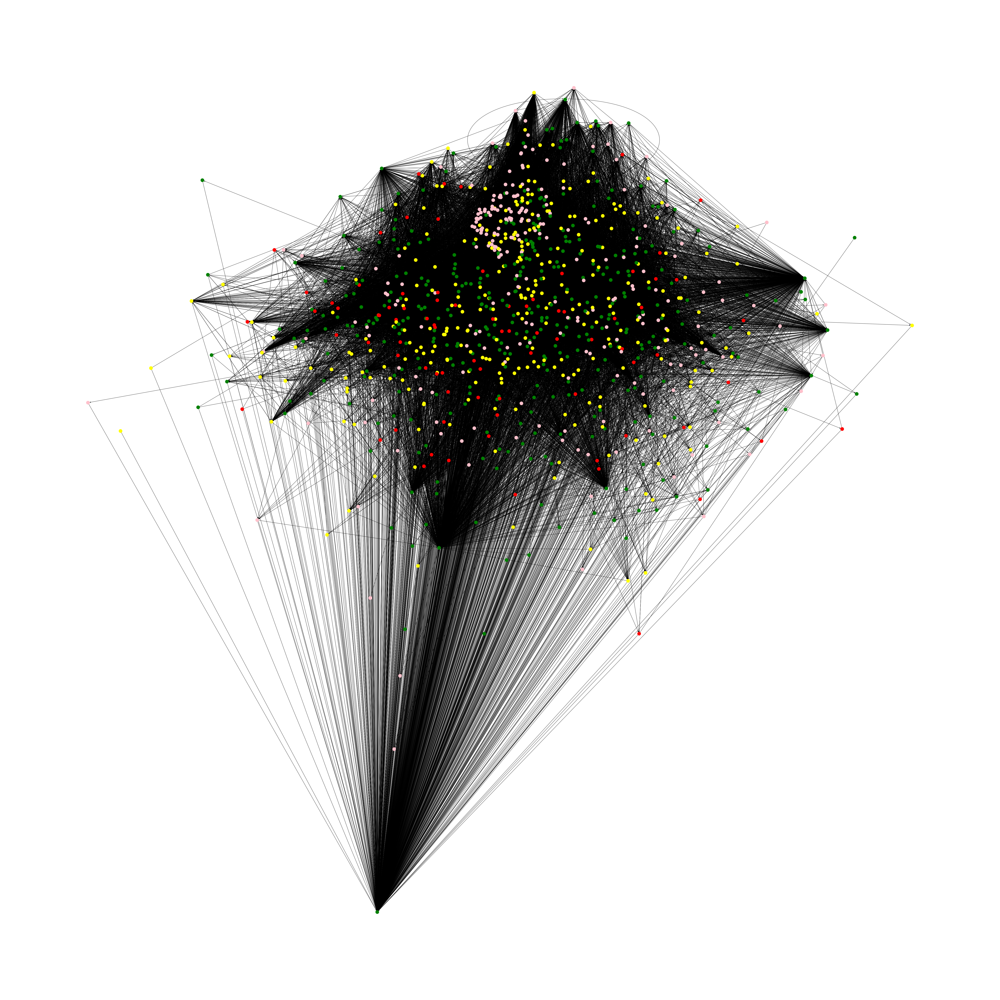

In [116]:
G = draw_graph(adj, Labels)

### ANN

Creating X and Y train 

In [151]:
df = centrality_dataframe.copy()

# These are the ground truth labels
labelling = Labels.copy()

# Training data
X = []
Y = []

# Creating X and Y
for node in adj.keys():
    if node in labelling.keys():
        X.append(df.loc[node].values)
        Y.append(int(labelling[node]))

X = np.array(X)
Y = np.array(Y)

In [152]:
# One hot encoding Y
# We need to one-hot encode so what we can train the ANN
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder()

output_labels = np.array([0, 1, 2, 3]).reshape(-1, 1)
encoder.fit(output_labels)

Y = encoder.transform(Y.reshape(-1,1)).toarray()

In [164]:
print(len(Y))

464


Creating the ANN

In [190]:
from keras.models import Sequential
from keras.layers import Dense

# Creating the model
model = Sequential()

# Add the first layer
model.add(Dense(units=64, activation='relu', input_dim=X.shape[1]))

# Add another hidden layer
model.add(Dense(units=64, activation='relu'))

# Add another hidden layer
model.add(Dense(units=64, activation='relu'))

# Add another hidden layer
model.add(Dense(units=64, activation='relu'))

# Add the output layer
model.add(Dense(units=4, activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

Training and evaluation (ANN)

In [183]:
'''from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, 
    Y,
    test_size = 0.3
)'''

'from sklearn.model_selection import train_test_split\nX_train, X_test, y_train, y_test = train_test_split(\n    X, \n    Y,\n    test_size = 0.3\n)'

In [191]:
print(len(X))

464


In [192]:
# Train the model
model.fit(X, Y, epochs=50)

Epoch 1/50
15/15 [==============================] - 1s 4ms/step - loss: 1.3650 - accuracy: 0.3297
Epoch 2/50
15/15 [==============================] - 0s 3ms/step - loss: 1.3002 - accuracy: 0.3987
Epoch 3/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2593 - accuracy: 0.4030
Epoch 4/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2638 - accuracy: 0.4030
Epoch 5/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2579 - accuracy: 0.4030
Epoch 6/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2557 - accuracy: 0.4030
Epoch 7/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2560 - accuracy: 0.4030
Epoch 8/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2547 - accuracy: 0.4030
Epoch 9/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2534 - accuracy: 0.4030
Epoch 10/50
15/15 [==============================] - 0s 3ms/step - loss: 1.2519 - accuracy: 0.4030
Epoch 11/50
15/15 [

In [193]:
# Labelling the remaining nodes using the model
X_new = []
X_new_nodes = []
for node in adj.keys():
    if node not in start_labels:
        X_new.append(df.loc[node].values)
        X_new_nodes.append(node)    
X_new = np.array(X_new)

In [194]:
X_new

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.22016688e-01, 0.00000000e+00, 2.33652919e-04],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.49794086e-01, 2.26369721e-03, 2.12153562e-03],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.97357422e-01, 3.85871809e-04, 6.42453298e-04],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.35621482e-01, 0.00000000e+00, 2.02550386e-04],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.86596958e-01, 1.35218176e-04, 7.66144520e-04],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.44543214e-01, 6.75604383e-06, 2.48325431e-04]])

In [195]:
# Predict the labels for remaining nodes
y_pred = model.predict(X_new)
# Decoding the labels
y_pred = np.argmax(y_pred, axis=1)

In [196]:
print(y_pred)

[1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 2 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 2 2 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1
 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 2 1 2 2 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 2 2 1 1 1 1 1 1 2 1 2 1 2 1 1 1 2 1 1 1 1 1 1 1 2 1 2 2 1 1 1 2 1 1 1 2
 1 1 1 2 1 1 1 1 1 2 2 1 1 1 1 2 1 1 1 1 1 2 1 1 1 1 1 1 1 2 1 1 2 1 1 2 1
 1 1 1 2 1 2 1 2 1 1 1 1 

In [197]:
for i in range(len(X_new_nodes)):
    Labels[X_new_nodes[i]] = y_pred[i]

In [198]:
print(Labels)

{'https://en.wikipedia.org/wiki/Absolute_value': 1, 'https://en.wikipedia.org/wiki/Addition_theorem': 1, 'https://en.wikipedia.org/wiki/Adjugate_matrix': 2, 'https://en.wikipedia.org/wiki/Algebra_of_sets': 2, 'https://en.wikipedia.org/wiki/Algorithm': 2, 'https://en.wikipedia.org/wiki/Altitude_(triangle)': 2, 'https://en.wikipedia.org/wiki/Angle_bisector_theorem': 1, 'https://en.wikipedia.org/wiki/Antiderivative': 2, 'https://en.wikipedia.org/wiki/Area_under_the_curve_(pharmacokinetics)': 3, 'https://en.wikipedia.org/wiki/Arithmetic_mean': 1, 'https://en.wikipedia.org/wiki/Arithmetic_progression': 1, 'https://en.wikipedia.org/wiki/Arithmetico%E2%80%93geometric_sequence': 2, 'https://en.wikipedia.org/wiki/Arithmetico–geometric_sequence': 3, 'https://en.wikipedia.org/wiki/Asymptote': 2, 'https://en.wikipedia.org/wiki/Basis_(linear_algebra)': 2, 'https://en.wikipedia.org/wiki/Bayes%27_theorem': 2, 'https://en.wikipedia.org/wiki/Bayesian_probability': 3, 'https://en.wikipedia.org/wiki/Benn

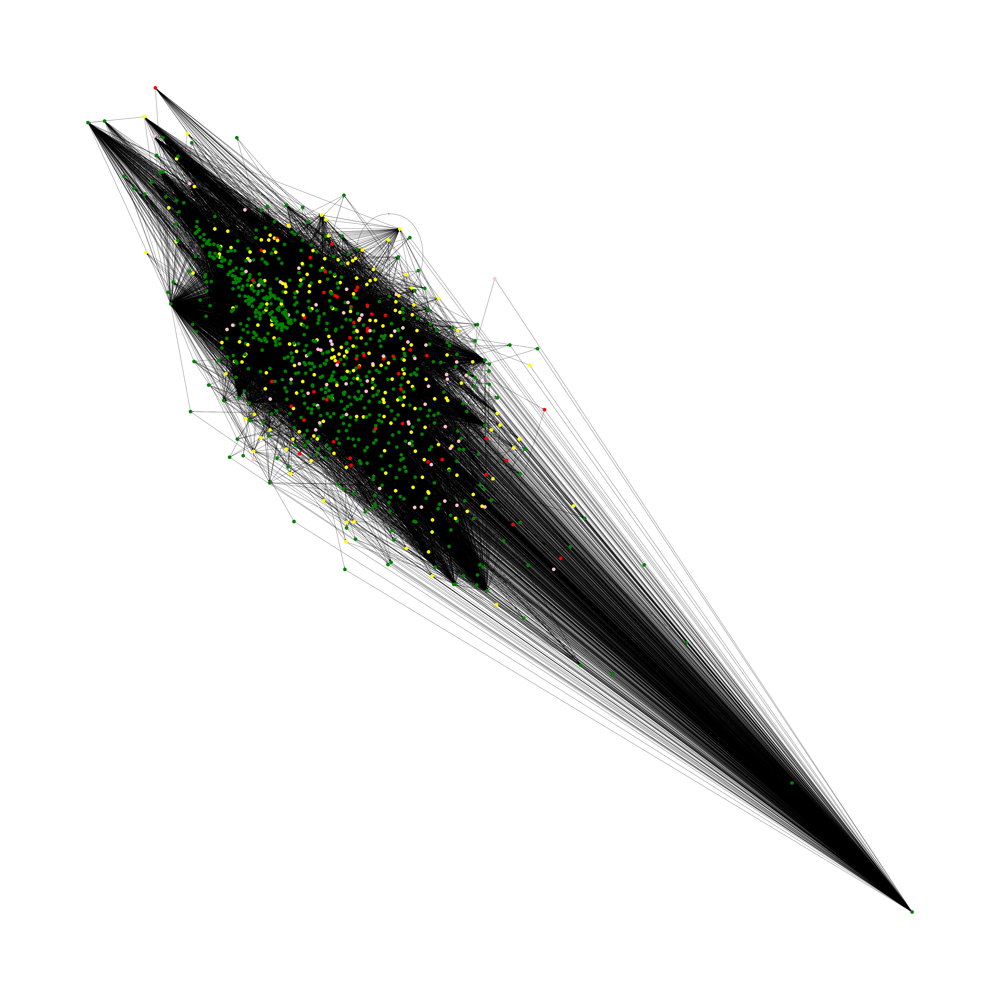

In [199]:
G = draw_graph(adj, Labels)

Graph Traversal

In [200]:
visited = [] # List for visited nodes.
queue = [] # Initialize a queue

def BFS_Traversal(visited, graph, node): #function for BFS
  visited.append(node)
  queue.append(node)

  while queue:          # Creating loop to visit each node
    m = queue.pop(0) 
    print (m) 

    for neighbour in graph[m]:
      if neighbour not in visited:
        visited.append(neighbour)
        queue.append(neighbour)

# Taking a random root node
root_node = list(adj.keys())[0]
print("BFS Traversal is as follows:")
BFS_Traversal(visited, adj, root_node)    # function calling

BFS Traversal is as follows:
https://en.wikipedia.org/wiki/Absolute_value
https://en.wikipedia.org/wiki/Antiderivative
https://en.wikipedia.org/wiki/Complex_conjugate
https://en.wikipedia.org/wiki/Complex_number
https://en.wikipedia.org/wiki/Complex_plane
https://en.wikipedia.org/wiki/Constant_of_integration
https://en.wikipedia.org/wiki/Continuous_function
https://en.wikipedia.org/wiki/Convex_function
https://en.wikipedia.org/wiki/Determinant
https://en.wikipedia.org/wiki/Distance
https://en.wikipedia.org/wiki/Euclidean_space
https://en.wikipedia.org/wiki/Inner_product_space
https://en.wikipedia.org/wiki/Interval_(mathematics)
https://en.wikipedia.org/wiki/Inverse_function
https://en.wikipedia.org/wiki/Mathematics
https://en.wikipedia.org/wiki/Monotonic_function
https://en.wikipedia.org/wiki/Multiplicative_inverse
https://en.wikipedia.org/wiki/Norm_(mathematics)
https://en.wikipedia.org/wiki/Pythagorean_theorem
https://en.wikipedia.org/wiki/Real_number
https://en.wikipedia.org/wiki/Si

Article Ordering Algorithm


Initializing the Distance Dictionary

In [201]:
distance = dict()

Function to calculate shortest distance from one node to all other nodes

In [202]:
def shortest_distance_using_BFS(source, adj):
    # Initialize the distance dictionary
    distance = {}
    # Initialize distances with infinity
    for node in adj.keys():
        distance[node] = np.inf
    # Initialize the visited dictionary
    visited = {}
    # Initialize the queue
    queue = []
    # Mark the source node as visited
    visited[source] = True
    # Initialize the distance of the source node to 0
    distance[source] = 0
    # Add the source node to the queue
    queue.append(source)
    # While the queue is not empty
    while queue:
        # Pop the first element from the queue
        n = queue.pop(0)
        # Get the neighbors of the node
        neighbors = adj[n].copy()
        # For each neighbor
        for neighbor in neighbors:
            # If the neighbor is not visited
            if neighbor not in visited:
                # Mark the neighbor as visited
                visited[neighbor] = True
                # Update the distance of the neighbor
                distance[neighbor] = distance[n] + 1
                # Add the neighbor to the queue
                queue.append(neighbor)
    # Return the distance dictionary
    return distance        


Function to calculate shortest path between all pairs of nodes

In [203]:
def shortest_path_between_all_pairs(adj):
    global distance
    # Initialize the distance matrix
    for node in adj.keys():
        distance[node] = shortest_distance_using_BFS(node, adj)

shortest_path_between_all_pairs(adj)

In [204]:
testLink = list(adj.keys())[0]
fixed_radius = 2
neighbours = []
for node in distance[testLink]:
    if(distance[testLink][node] <= fixed_radius or distance[node][testLink] <= fixed_radius):
        neighbours.append(node)

In [206]:
labels = []
for node in neighbours:
    if(int(Labels[node]) != 0):
      labels.append((node, int(Labels[node])))

labels = sorted(labels, key=lambda x: x[1])

In [207]:
print("Recommendations for", testLink)
for link, rating in labels:
    # Print the link and the difficulty rating
    print(link, int(rating))

Recommendations for https://en.wikipedia.org/wiki/Absolute_value
https://en.wikipedia.org/wiki/Absolute_value 1
https://en.wikipedia.org/wiki/Completing_the_square 1
https://en.wikipedia.org/wiki/Complex_conjugate 1
https://en.wikipedia.org/wiki/Derivative 1
https://en.wikipedia.org/wiki/Euclidean_vector 1
https://en.wikipedia.org/wiki/Even_and_odd_functions 1
https://en.wikipedia.org/wiki/Focus_(geometry) 1
https://en.wikipedia.org/wiki/Function_of_a_real_variable 1
https://en.wikipedia.org/wiki/Geometric_series 1
https://en.wikipedia.org/wiki/Integral 1
https://en.wikipedia.org/wiki/Integration_by_substitution 1
https://en.wikipedia.org/wiki/Line_integral 1
https://en.wikipedia.org/wiki/Logarithm 1
https://en.wikipedia.org/wiki/Median 1
https://en.wikipedia.org/wiki/Multiplicative_inverse 1
https://en.wikipedia.org/wiki/Orthogonal_matrix 1
https://en.wikipedia.org/wiki/Polynomial 1
https://en.wikipedia.org/wiki/Prime_number 1
https://en.wikipedia.org/wiki/Pythagorean_theorem 1
https:

Diameter 

In [208]:
#Diameter 
diameter = 0

for u in adj.keys():
  for v in adj.keys():
    if u != v:
      d = distance[u][v]
      if d == np.inf:
        continue
      if d > diameter:
        diameter = d

print("Diameter of the Graph is:", diameter)

Diameter of the Graph is: 7


Tried to implement GNN

In [209]:
#!pip install dgl

In [210]:
'''import dgl
import networkx as nx
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from matplotlib import pyplot as plt
torch.set_printoptions(sci_mode=False)'''

'import dgl\nimport networkx as nx\nimport numpy as np\nimport torch\nimport torch.nn as nn\nimport torch.nn.functional as F\nfrom matplotlib import pyplot as plt\ntorch.set_printoptions(sci_mode=False)'

In [211]:
'''import dgl.data

dataset = dgl.data.CoraGraphDataset()
print('Number of categories:', dataset.num_classes)'''

"import dgl.data\n\ndataset = dgl.data.CoraGraphDataset()\nprint('Number of categories:', dataset.num_classes)"

In [212]:
'''g = dataset[0]
print('Node features', g.ndata)
print('Edge features', g.edata)'''

"g = dataset[0]\nprint('Node features', g.ndata)\nprint('Edge features', g.edata)"

In [213]:
'''from dgl.nn import GraphConv

class GNN(nn.Module):
    def __init__(self, in_feats, h_feats, num_classes):
        super(GNN, self).__init__()
        self.conv1 = GraphConv(in_feats, h_feats)
        self.conv2 = GraphConv(h_feats, num_classes)

    def forward(self, g, in_feat):
        h = self.conv1(g, in_feat)
        h = F.relu(h)
        h = self.conv2(g, h)
        return h'''

'from dgl.nn import GraphConv\n\nclass GNN(nn.Module):\n    def __init__(self, in_feats, h_feats, num_classes):\n        super(GNN, self).__init__()\n        self.conv1 = GraphConv(in_feats, h_feats)\n        self.conv2 = GraphConv(h_feats, num_classes)\n\n    def forward(self, g, in_feat):\n        h = self.conv1(g, in_feat)\n        h = F.relu(h)\n        h = self.conv2(g, h)\n        return h'

In [214]:
'''# Create the model with given dimensions
model = GNN(g.ndata['feat'].shape[1], 16, dataset.num_classes)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
best_val_acc = 0
best_test_acc = 0

features = g.ndata['feat']
labels = g.ndata['label']

train_mask = g.ndata['train_mask']
val_mask = g.ndata['val_mask']
test_mask = g.ndata['test_mask']
for e in range(100):
    # Forward
    logits = model(g, features)

    # Compute prediction
    pred = logits.argmax(1)

    # Compute loss
    # Note that you should only compute the losses of the nodes in the training set.
    loss = F.cross_entropy(logits[train_mask], labels[train_mask])

    # Compute accuracy on training/validation/test
    train_acc = (pred[train_mask] == labels[train_mask]).float().mean()
    val_acc = (pred[val_mask] == labels[val_mask]).float().mean()
    test_acc = (pred[test_mask] == labels[test_mask]).float().mean()

    # Save the best validation accuracy and the corresponding test accuracy.
    if best_val_acc < val_acc:
        best_val_acc = val_acc
        best_test_acc = test_acc

    # Backward
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if e % 5 == 0:
        print('In epoch {}, loss: {:.3f}, val acc: {:.3f} (best {:.3f}), test acc: {:.3f} (best {:.3f})'.format(
            e, loss, val_acc, best_val_acc, test_acc, best_test_acc))'''

"# Create the model with given dimensions\nmodel = GNN(g.ndata['feat'].shape[1], 16, dataset.num_classes)\noptimizer = torch.optim.Adam(model.parameters(), lr=0.01)\nbest_val_acc = 0\nbest_test_acc = 0\n\nfeatures = g.ndata['feat']\nlabels = g.ndata['label']\n\ntrain_mask = g.ndata['train_mask']\nval_mask = g.ndata['val_mask']\ntest_mask = g.ndata['test_mask']\nfor e in range(100):\n    # Forward\n    logits = model(g, features)\n\n    # Compute prediction\n    pred = logits.argmax(1)\n\n    # Compute loss\n    # Note that you should only compute the losses of the nodes in the training set.\n    loss = F.cross_entropy(logits[train_mask], labels[train_mask])\n\n    # Compute accuracy on training/validation/test\n    train_acc = (pred[train_mask] == labels[train_mask]).float().mean()\n    val_acc = (pred[val_mask] == labels[val_mask]).float().mean()\n    test_acc = (pred[test_mask] == labels[test_mask]).float().mean()\n\n    # Save the best validation accuracy and the corresponding test 

In [215]:
'''list(model.named_parameters())'''

'list(model.named_parameters())'